In [1]:
""" 
Author: p.wagner@bhvi.org / p.wagner@unsw.edu.au 
image registration of anterior segment projection from several scans 

Purpose: 
from OCT choroid thickness data eliminate region of disinterest (ONH) using annotated image, then 
apply rigid body translation found by im_reg_ref_to_best_quality_oct.jpynb, then 
average for initial and post scans and calculate the map for delta and std

"""
import pandas as pd
import numpy as np
import os.path
from pathlib import Path
from pystackreg import StackReg
from skimage import io
import sys
import time
sys.path.append(r'C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers')
from oct_helpers_lib import OctDataAccess as get_px_meta
from oct_helpers_lib import TopconSegmentationData as TSD

import cv2
import glob
from PIL import Image
import plotly.graph_objects as go
import matplotlib.pyplot as plt

path_oct = r'E:\studyIII\OCT_data'
path_logbook = r'C:\Users\p.wagner\Documents\phd\C4 study_III\participants'
fn_logbook = 'participant_log_studyIII_V0.2.xlsx' 
fp_fn_logbook = os.path.join(path_logbook, fn_logbook)
thickness_csv = 'DEFAULT_3D_All_Thickness.csv'


# check if path_oct is available 
if not os.path.isdir(path_oct):
    print('OCT data path NOT available')

OCT data path NOT available


In [6]:
# find instances of 'images_Sequence_Proj_Iowa_ONH_ident2.png' not in folder 
px_ids = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 26, ]
scan_types = ['OCT_initial_OD', 'OCT_initial_OS', 'OCT_post_OD', 'OCT_post_OS']

px_details = get_px_meta(fp_fn_logbook, px_ids, scan_types, path_oct)

for fp in sorted(px_details.oct_scans_fp, key=lambda x: x.split('\\')[-2]):
    fp_fn = os.path.join(fp, 'images_Sequence', 'images_Sequence_Proj_Iowa.tif')
    if not Path(fp_fn).exists():
        print(fp)


In [7]:
# find instances of 'images_Sequence_Proj_Iowa_ONH_ident2.png' not in folder 
px_ids = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 26, ]
scan_types = ['OCT_initial_OD', 'OCT_initial_OS', 'OCT_post_OD', 'OCT_post_OS']

px_details = get_px_meta(fp_fn_logbook, px_ids, scan_types, path_oct)

for fp in sorted(px_details.oct_scans_fp, key=lambda x: x.split('\\')[-2]):
    fp_fn = os.path.join(fp, 'images_Sequence_Proj_Iowa_ONH_ident2.png')
    if not Path(fp_fn).exists():
        print(fp)

In [ ]:
px_ids = [ 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 20, 23, 26]
# px_ids = [2, ]

for px_id in px_ids: 
    scan_types_all = ['OCT_initial_OD', 'OCT_post_OD', 'OCT_initial_OS', 'OCT_post_OS']
    
    px_meta_data_all = get_px_meta(fp_fn_logbook, [px_id, ], scan_types_all, path_oct)
    # read thickness data file    
    oct_data_fn_fp = os.path.join(px_meta_data_all.subject_rec_fp[0], thickness_csv)
    oct_thicness_data_all = pd.read_csv(oct_data_fn_fp, dtype=str, names=list(range(0,513, 1)), low_memory=False)
    
    
    # check data quality for each eye and asign best quality image as ref image
    # # OD
    scan_types_OD = ['OCT_initial_OD', 'OCT_post_OD', ]
    df = pd.DataFrame(columns=['quality', 'fp',])
    px_meta_data_OD = get_px_meta(fp_fn_logbook, [px_id, ], scan_types_OD, path_oct)
    for idx, fp in enumerate(px_meta_data_OD.oct_scans_fp):
        df = df.append(pd.DataFrame({'quality': [px_meta_data_OD.get_quality(oct_thicness_data_all, px_meta_data_OD.oct_scans_ids[idx])],
                                'fp': [fp]}))
        df = df.reset_index(drop=True)     
            # insert text on images here
        df_sorted = df.sort_values(by=['quality'], ascending=False).reset_index(drop=True)  
        #load reference image
        best_q_im_OD = io.imread(os.path.join(df_sorted.fp[0], 'images_Sequence', 'images_Sequence_Proj_Iowa.tif'))    
    # # OS 
    scan_types_OS = ['OCT_initial_OS', 'OCT_post_OS', ]
    df = pd.DataFrame(columns=['quality', 'fp',])
    px_meta_data_OS = get_px_meta(fp_fn_logbook, [px_id, ], scan_types_OS, path_oct)
    for idx, fp in enumerate(px_meta_data_OS.oct_scans_fp):
        df = df.append(pd.DataFrame({'quality': [px_meta_data_OS.get_quality(oct_thicness_data_all, px_meta_data_OS.oct_scans_ids[idx])],
                                'fp': [fp]}))
        df = df.reset_index(drop=True)     
            # insert text on images here
        df_sorted = df.sort_values(by=['quality'], ascending=False).reset_index(drop=True)  
        #load reference image
        best_q_im_OS = io.imread(os.path.join(df_sorted.fp[0], 'images_Sequence', 'images_Sequence_Proj_Iowa.tif')) 
    
    # collect some meta data 
    scans_meta_columns = ['px_id', 'scan_type', 'oct_scans_ids', 'oct_scan_quality', 'mean_std',
                      'std_std', 'max_maxmin', 'min_maxmin']
    scans_meta_data = pd.DataFrame(columns=scans_meta_columns) 
    
    
    # apply averageing to all images 
    for scan_type in scan_types_all:
        px_meta_data = get_px_meta(fp_fn_logbook, [px_id,], [scan_type,], path_oct)


        all_choroids = []
        for scan_id, fp in zip(px_meta_data.oct_scans_ids, px_meta_data.oct_scans_fp):
            oct_scan_data = TSD(oct_thicness_data_all, scan_id)

            z_data = oct_scan_data.choroid.values.astype(float)
            # # choroid data == 0 is impossible -> disregard but account during averaging across scans  
#             z_data[idxs[0], idxs[1]] = 0
            
            print(scan_type.split('_')[-1] )
            # # which eye need to be registered 
            if scan_type.split('_')[-1] == 'OD':
                ref_im = best_q_im_OD
            if scan_type.split('_')[-1] == 'OS':
                ref_im = best_q_im_OS
            
            # # calculate image regression 
            out_rot_im = np.zeros((256, 512, 3), dtype=float)
            # #load "moved" image
            mov_im = io.imread(os.path.join(fp, 'images_Sequence', 'images_Sequence_Proj_Iowa.tif'))
 
            if px_meta_data.log_master.loc['im_reg_type', px_meta_data.log_master.loc['px_id']==px_id][0] =='rbt':
                # # Rigid Body transformation
                sr = StackReg(StackReg.RIGID_BODY)
                out_rot = sr.register_transform(ref_im, mov_im)
                print('rbt')
            if px_meta_data.log_master.loc['im_reg_type', px_meta_data.log_master.loc['px_id']==px_id][0] =='tran':
                #Translational transformation
                # applied to px_id [3, 13
                sr = StackReg(StackReg.TRANSLATION)
                out_rot = sr.register_transform(ref_im, mov_im)
                print('tran')


            
            # # apply image regression
#             print(sr.get_matrix())
            z_data_reg = sr.transform(z_data)
            
            # register image (ONH annotation), find blue pixels as indication for ONH area and set to np.nan
            im_ONH = plt.imread(os.path.join(fp, 'images_Sequence_Proj_Iowa_ONH_ident2.png'))
            im_ONH_reg = im_ONH
            im_ONH_reg[:,:,0] = sr.transform(im_ONH[:,:,0])
            im_ONH_reg[:,:,1] = sr.transform(im_ONH[:,:,1])
            im_ONH_reg[:,:,2] = sr.transform(im_ONH[:,:,2])
            idxs = idxs = np.where((im_ONH_reg[:,:,2] > 0.98) & (im_ONH_reg[:,:,0] <0.05 ))
            z_data_reg[idxs] = np.nan            
            idxs_zeros = np.where(z_data_reg <30)
            z_data_reg[idxs_zeros] = np.nan
            
            all_choroids.append(z_data_reg)
        
        all_choroids = np.array(all_choroids)

        all_choroids_mean = np.nanmean(all_choroids, axis=0)
        all_choroids_std = np.nanstd(all_choroids, axis=0)
        all_choroids_max = np.nanmax(all_choroids, axis=0)
        all_choroids_min = np.nanmin(all_choroids, axis=0)

        # save all_choroids_mean for further analyses
        choroids_output_fn = os.path.join(px_meta_data.subject_rec_fp[0], 
                                          scan_type.split('_')[-1] + '_' + scan_type.split('_')[-2] + 
                                          '_choroid_mean_regV02.csv')
        df = pd.DataFrame(all_choroids_mean)
        df.to_csv(choroids_output_fn)
        
        all_choroids_mean.astype(int).shape
        quality_all = []
        for scan_id in px_meta_data.oct_scans_ids:
            quality_all.append(px_meta_data.get_quality(oct_thicness_data_all, scan_id))
        
        # gather scan meta data 
        scans_meta_data = scans_meta_data.append(pd.DataFrame({'px_id':px_meta_data.px_ids,
                                     'scan_type': px_meta_data.scan_types,
                                     'oct_scans_ids': str(px_meta_data.oct_scans_ids), 
                                     'oct_scan_quality': str(quality_all), 
                                     'mean_std': np.nanmean(all_choroids_std),
                                     'std_std': np.nanstd(all_choroids_std),
                                     'max_maxmin': np.nanmax(all_choroids_max - all_choroids_min),
                                     'min_maxmin': np.nanmin(all_choroids_max - all_choroids_min)
                                    }))
            
            
            
        TSD.create_averaging_figures(all_choroids_mean,
                                     all_choroids_std, 
                                     all_choroids_max,
                                     all_choroids_min,
                                     px_meta_data.px_ids, 
                                     quality_all, 
                                     scan_type, 
                                     px_meta_data.oct_scans_ids, 
                                     px_meta_data.subject_rec_fp[0])
#         del all_choroids_mean, all_choroids_std, all_choroids_max, all_choroids_min, z_data, z_data_reg, df, quality_all
    
    # save scan meta data 
    scans_meta_output_fn = os.path.join(px_meta_data.subject_rec_fp[0], 
                                    'scans_summery_regV02.csv')
    scans_meta_data.to_csv(scans_meta_output_fn)
    
    del oct_thicness_data_all
    
    
print('finished')

OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in less


OD
tran
OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning: Mean of empty slice
C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning: All-NaN slice encountered
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning: All-NaN slice encountered
C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:824: RuntimeWarning:

invalid value encountered in greater_equal

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:825: RuntimeWarning:

invalid value encountered in less_equal

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:162: RuntimeWarning:

in

OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
tran
OD
tran
OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered



OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:824: RuntimeWarning:

invalid value encountered in greater_equal

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\histograms.py:825: RuntimeWarning:

invalid value encountered in less_equal

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:162: RuntimeWarning:

invalid value e

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt


C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:172: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



OS
rbt
OS
rbt
OS
rbt


C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:164: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
tran
OD
tran
OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
tran
OD
tran
OD
tran
OD
tran
OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
tran
OD
tran


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
tran
OD
tran
OD
tran
OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OS
tran
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning:

invalid value encountered in less



OD
rbt
OD
rbt
OD
rbt


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:103: RuntimeWarning:

Mean of empty slice

C:\ProgramData\Anaconda3\lib\site-packages\numpy\lib\nanfunctions.py:1628: RuntimeWarning:

Degrees of freedom <= 0 for slice.

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning:

All-NaN slice encountered

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:106: RuntimeWarning:

All-NaN slice encountered

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:129: RuntimeWarning:

invalid value encountered in greater

C:\Users\p.wagner\Documents\Python Scripts\oct_data_analyses_helpers\oct_helpers_lib.py:130: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

C:\ProgramData\Anaconda3

OD
rbt
OD
rbt
OD
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
OS
rbt
finished


(array([], dtype=int64), array([], dtype=int64))

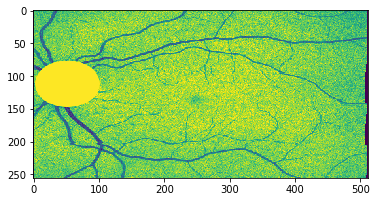

In [6]:
# os.path.join(path_oct, '**\\scans_summery.csv')

im_ONH =plt.imread(os.path.join(fp, 'images_Sequence_Proj_Iowa_ONH_ident2.png'))
plt.imshow(im_ONH[:,:,2])
idxs = np.where(np.all(im_ONH_reg == [0, 0 , 1], axis=-1))
idxs

In [46]:

idxs_zeros = np.where(z_data_reg <30)
idxs_zeros

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: RuntimeWarning:

invalid value encountered in less



(array([101, 101, 101, 101, 102, 102, 102, 102, 102, 102, 103, 103, 103,
        103, 103, 104, 104, 104, 104, 104, 105, 105, 105, 105, 106, 106,
        106, 106, 107, 108, 108, 108, 108, 109, 109, 109, 109, 110, 110,
        110, 110, 111, 111, 111, 111, 112, 112, 112, 113, 113, 113, 113,
        114, 114, 114, 114, 115, 115, 115, 115, 116, 116, 116, 116, 117,
        117, 117, 117, 118, 118, 118], dtype=int64),
 array([1, 2, 4, 5, 0, 1, 2, 3, 4, 5, 0, 1, 2, 3, 4, 0, 1, 2, 3, 4, 0, 1,
        2, 3, 0, 1, 2, 3, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2,
        3, 0, 1, 2, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1, 2, 3, 0, 1,
        2, 3, 1, 2, 3], dtype=int64))

In [38]:
z_data_reg

array([[217.25999451, 217.26000977, 219.83999634, ..., 307.77999878,
        302.60998535, 297.43997192],
       [227.59999084, 230.19000244, 230.19000244, ..., 281.92001343,
        276.74002075, 271.57000732],
       [219.83999634, 222.42999268, 222.42999268, ..., 294.8500061 ,
        289.67999268, 281.91998291],
       ...,
       [137.08000183, 139.66999817, 137.08000183, ..., 300.01998901,
        297.44000244, 287.08999634],
       [152.59999084, 152.59999084, 152.6000061 , ..., 292.25997925,
        292.26000977, 281.92001343],
       [129.32000732, 129.32000732, 129.31999207, ..., 300.01998901,
        294.8500061 , 289.67999268]])

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:6692: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  sort=sort)


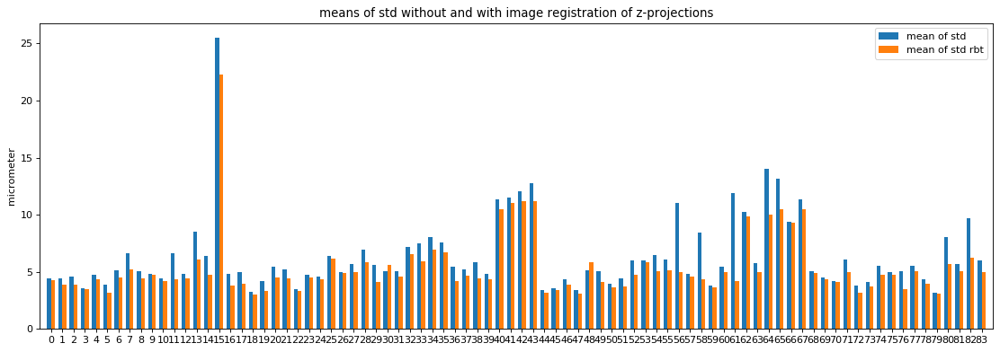

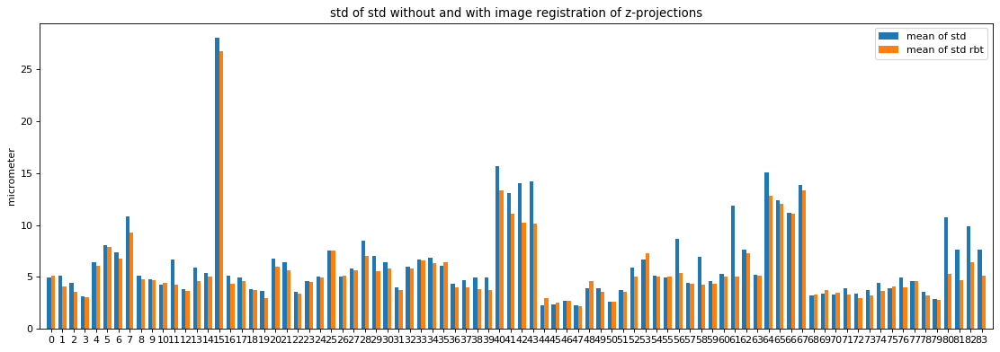

In [4]:
all_scans_meta_columns = ['px_id', 'scan_type', 'oct_scans_ids', 'oct_scan_quality', 'mean_std',
                      'std_std', 'max_maxmin', 'min_maxmin', 
                     'px_id_rbt', 'scan_type_rbt', 'oct_scans_ids_rbt', 'oct_scan_quality_rbt', 'mean_std_rbt',
                      'std_std_rbt', 'max_maxmin_rbt', 'min_maxmin_rbt']
all_scans_meta_data = pd.DataFrame(columns=scans_meta_columns) 

for fn, fn_rbt in zip(glob.glob(os.path.join(path_oct, '**\\scans_summery.csv')), 
                      glob.glob(os.path.join(path_oct, '**\\scans_summery_reg.csv'))):
    
    df_new = pd.read_csv(fn, index_col=0)
    
    df_new_rbt = pd.read_csv(fn_rbt, index_col=0)
    df_new_rbt.columns = df_new_rbt.columns + '_rbt'
    
    df = pd.concat([df_new, df_new_rbt], axis=1)
    
    all_scans_meta_data = all_scans_meta_data.append(df)

scans_meta_output_fn = os.path.join(path_oct, 'all_scans_summery.csv')    
all_scans_meta_data.to_csv(scans_meta_output_fn)


fig, ax = plt.subplots(figsize=(14, 5), dpi=80)

x = np.arange(len(all_scans_meta_data['mean_std']))  # the label locations
width = 0.35  # the width of the bars

rects1 = ax.bar(x - width/2, all_scans_meta_data['mean_std'], width, label='mean of std')
rects2 = ax.bar(x + width/2, all_scans_meta_data['mean_std_rbt'], width, label='mean of std rbt')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('micrometer')
ax.set_title('means of std without and with image registration of z-projections')
ax.set_xticks(x)
# ax.set_xticklabels(labels)
ax.legend()

fig.tight_layout()
plt.xlim([-1, len(all_scans_meta_data['mean_std'])])
plt.show()

fig, ax = plt.subplots(figsize=(14, 5), dpi=80)

x = np.arange(len(all_scans_meta_data['mean_std']))  # the label locations
width = 0.35  # the width of the bars

rects1 = ax.bar(x - width/2, all_scans_meta_data['std_std'], width, label='mean of std')
rects2 = ax.bar(x + width/2, all_scans_meta_data['std_std_rbt'], width, label='mean of std rbt')

# Add some text for labels, title and custom x-axis tick labels, etc.
ax.set_ylabel('micrometer')
ax.set_title('std of std without and with image registration of z-projections')
ax.set_xticks(x)
# ax.set_xticklabels(labels)
ax.legend()

fig.tight_layout()
plt.xlim([-1, len(all_scans_meta_data['mean_std'])])
plt.show()


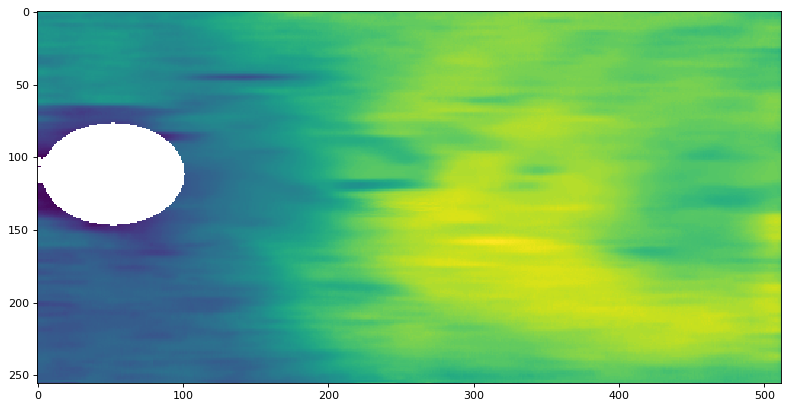

In [48]:
# all_scans_meta_data =  all_scans_meta_data.reset_index()
# all_scans_meta_data[all_scans_meta_data.px_id == 11]
plt.figure(figsize=(12, 8), dpi=80)
plt.imshow(z_data_reg)

In [49]:
# im_output_fn = scan_types[0].split('_')[-1] + '_' + scan_types[0].split('_')[-2] +'_mean_choroid_thickness.png'

# del all_choroids_mean, all_choroids_std, all_choroids_max, all_choroids_min, z_data, z_data_reg, df, quality_all


# # display choroid values 
fig = go.Figure(data=[go.Surface(z=all_choroids_mean)])
title_name = ('PX_id: '  + ', Scan Nr: ' + str(scan_id) + 
              ', Quality: '+  str(oct_scan_data.scan_quality)) 
fig.update_layout(title=title_name, autosize=False,
                  scene_camera_eye=dict(x=0.5, y=-10, z=-20),
                  width=900, height=900,
                  margin=dict(l=50, r=50, b=50, t=50))
# fig.update_layout(scene = dict(xaxis = dict(nticks=10, range=[0,512],),
#                                yaxis = dict(nticks=10, range=[0,256],),
#                                zaxis = dict(nticks=10, range=[0,500],),),
#                   scene_aspectmode='manual', 
#                   scene_aspectratio=dict(x=12, y=9, z=10)
#                   )

fig.show()
# fig.write_image(os.path.join(px_meta_data.subject_rec_fp[0], 'images', im_output_fn))

In [52]:
im_output_fn = scan_types[0].split('_')[-1] + '_' + scan_types[0].split('_')[-2] +'_std_choroid_thickness.png'
# # display choroid values 
fig = go.Figure(data=[go.Surface(z=all_choroids_std)])
# title_name = ('PX_id: '  + ', Scan Nr: ' + str(scan_id) + 
#               ', Quality: '+  str(oct_scan_data.scan_quality)) 
fig.update_layout(title=title_name, autosize=False,
                  scene_camera_eye=dict(x=0, y=-10, z=20),
                  width=900, height=900,
                  margin=dict(l=50, r=50, b=50, t=50))
fig.update_layout(scene = dict(xaxis = dict(nticks=10, range=[0,512],),
                               yaxis = dict(nticks=10, range=[0,256],),
                               zaxis = dict(nticks=10, range=[0,100],),),
                  scene_aspectmode='manual', 
                  scene_aspectratio=dict(x=12, y=9, z=10)
                  )

fig.show()
fig.write_image(os.path.join(px_meta_data.subject_rec_fp[0], 'images', im_output_fn))

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning:

invalid value encountered in greater



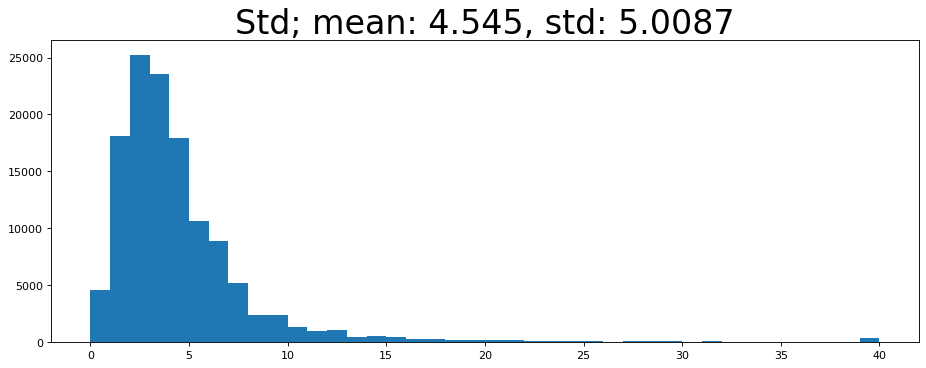

In [167]:
im_output_fn = scan_types[0].split('_')[-1] + '_' + scan_types[0].split('_')[-2] +'_hist_std_choroid_thickness.png'
disp_data_all_choroids_std = all_choroids_std.flatten()
disp_data_all_choroids_std[disp_data_all_choroids_std > 40] = 40
fig4 = plt.figure(figsize=(14, 5), dpi=80)
fig4 = plt.hist(disp_data_all_choroids_std, 40)
fig4 = plt.title('Std; mean: ' + str(np.round(np.nanmean(all_choroids_std),4))+ ', std: '+ 
          str(np.round(np.nanstd(all_choroids_std), 4) ) , fontsize=30 )

plt.savefig(os.path.join(px_meta_data.subject_rec_fp[0], 'images', im_output_fn))

In [3]:
# fig5_output_fn = scan_types[0].split('_')[-1] + '_' + scan_types[0].split('_')[-2] +'_minmax_choroid_thickness.png'
# # display choroid values 
fig5 = go.Figure(data=[go.Surface(z=(all_choroids_max - all_choroids_min))])
fig5_title_name = ('PX_id: '  + ', max-min values ' + str(scan_id) + 
              ', Quality: '+  str(oct_scan_data.scan_quality) ) 
fig5.update_layout(title=fig5_title_name, autosize=False,
                  scene_camera_eye=dict(x=0, y=-10, z=20),
                  width=900, height=900,
                  margin=dict(l=50, r=50, b=50, t=50))

fig5.update_layout(scene = dict(xaxis = dict(nticks=10, range=[0,512],),
                               yaxis = dict(nticks=10, range=[0,256],),
                               zaxis = dict(nticks=10, range=[0,200],),),
                  scene_aspectmode='manual', 
                  scene_aspectratio=dict(x=12, y=9, z=10)
                  )

fig5.show()
# fig5.write_image(os.path.join(px_meta_data.subject_rec_fp[0], 'images', fig5_output_fn))

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: RuntimeWarning:

invalid value encountered in greater



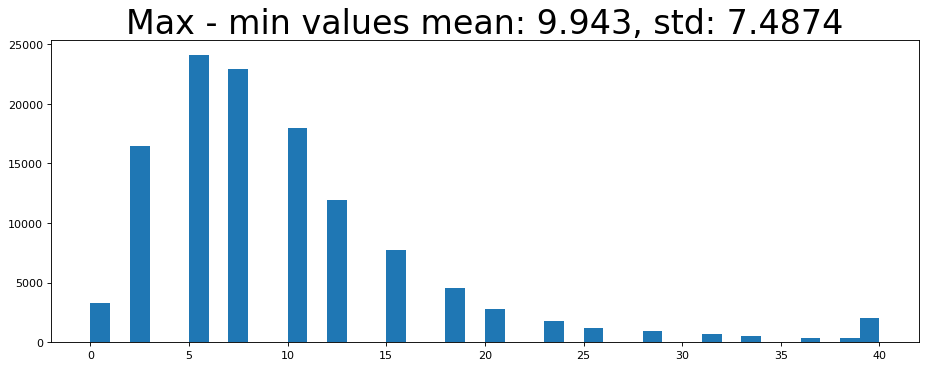

In [170]:
fig6_output_fn = scan_types[0].split('_')[-1] + '_' + scan_types[0].split('_')[-2] +'_hist_minmax_choroid_thickness.png'

min_max = all_choroids_max - all_choroids_min
min_max = min_max.flatten()
min_max[min_max > 40] = 40


fig6 = plt.figure(figsize=(14, 5), dpi=80)
fig6 = plt.hist(min_max, 40)
fig6 = plt.title('Max - min values mean: ' + str(np.round(np.nanmean(min_max), 4))+ ', std: '+ 
          str(np.round(np.nanstd(min_max), 4)), fontsize=30 )

plt.savefig(os.path.join(px_meta_data.subject_rec_fp[0], 'images', fig6_output_fn))


(array([], dtype=int64), array([], dtype=int64))

In [98]:
im_output_fn_d = (scan_types[0].split('_')[-1] + '_' + scan_types[0].split('_')[-2] +
                '_mean_direct_view_choroid_thickness.png')

# # display choroid values
fig1 = go.Figure(data=[go.Surface(z=all_choroids_mean)])
fig1_title_name = ('PX_id: ' + ', Scan Nr: ' + str(scan_id) +
              ', Quality: ')
fig1.update_layout(title=fig1_title_name, autosize=False,
                  scene_camera_eye=dict(x=0.5, y=-10, z=-20),
                  width=900, height=900,
                  margin=dict(l=50, r=50, b=50, t=50))
fig1.update_layout(scene=dict(xaxis=dict(nticks=10, range=[0, 512], ),
                             yaxis=dict(nticks=10, range=[0, 256], ),
                             zaxis=dict(nticks=10, range=[0, 500], ), ),
                  scene_aspectmode='manual',
                  scene_aspectratio=dict(x=12, y=9, z=10)
                  )

fig1.write_image(os.path.join(px_meta_data.subject_rec_fp[0], 'images', im_output_fn_d))

im_output_fn_i = (scan_types[0].split('_')[-1] + '_' + scan_types[0].split('_')[-2] +
                '_mean_indirect_view_hist_minmax_choroid_thickness.png')

# # count of detected gaze per target with high confidence
fig2 = go.Figure(data=[go.Surface(z=all_choroids_mean)])
fig2_title_name = ('PX_id: ' + ', Scan Nr: ' 
                    ', Quality: ')
fig2.update_layout(title=fig2_title_name, autosize=False,
                  scene_camera_eye=dict(x=0.5, y=-10, z=20),
                  width=900, height=900,
                  margin=dict(l=50, r=50, b=50, t=50))
fig2.update_layout(scene=dict(xaxis=dict(nticks=10, range=[0, 512], ),
                             yaxis=dict(nticks=10, range=[0, 256], ),
                             zaxis=dict(nticks=10, range=[0, 500], ), ),
                  scene_aspectmode='manual',
                  scene_aspectratio=dict(x=12, y=9, z=10)
                  )

fig2.write_image(os.path.join(px_meta_data.subject_rec_fp[0], 'images', im_output_fn_i))

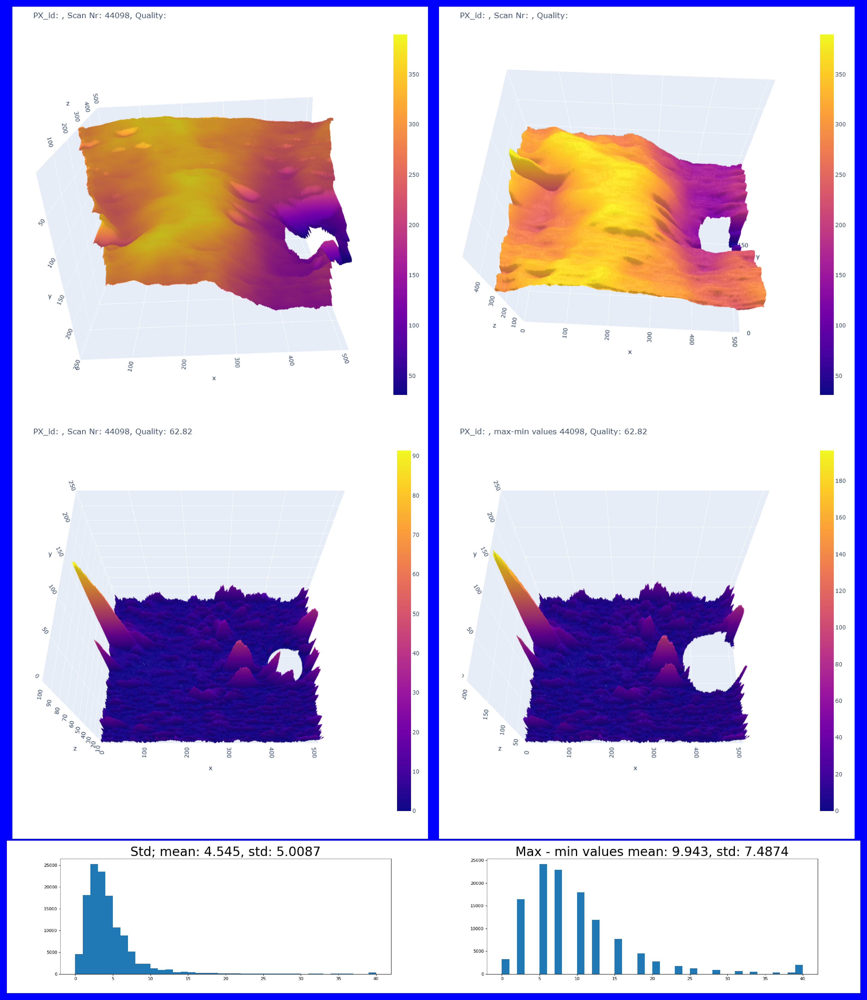

In [163]:
import matplotlib.image as mpimg

fig = plt.figure(figsize=(16, 20), dpi=300, facecolor='blue', edgecolor='k')

grid = plt.GridSpec(20, 16, wspace=0, hspace=0)
# From this we can specify subplot locations and extents using the familiary Python slicing syntax:

fig1 = plt.subplot(grid[0:8, 0:8])

fig1 = plt.axis('off')
fig1 = plt.imshow(mpimg.imread(os.path.join(px_meta_data.subject_rec_fp[0], 'images', im_output_fn_d)))


fig2 = plt.subplot(grid[0:8, 8:16])

fig2 = plt.axis('off')
fig2 = plt.imshow(mpimg.imread(os.path.join(px_meta_data.subject_rec_fp[0], 'images', im_output_fn_i)))


fig3 = plt.subplot(grid[8:16, 0:8])

fig3 = plt.axis('off')
fig3 = plt.imshow(mpimg.imread(os.path.join(px_meta_data.subject_rec_fp[0], 'images', 'OD_initial_std_choroid_thickness.png')))



fig4 = plt.subplot(grid[8:16, 8:16])

fig4 = plt.axis('off')
fig4 = plt.imshow(mpimg.imread(os.path.join(px_meta_data.subject_rec_fp[0], 'images', 'OD_initial_minmax_choroid_thickness.png')))


fig5 = plt.subplot(grid[16:19, 0:8])

fig5 = plt.axis('off')
fig5 = plt.imshow(mpimg.imread(os.path.join(px_meta_data.subject_rec_fp[0], 'images', 'OD_initial_hist_std_choroid_thickness.png')))



fig6 = plt.subplot(grid[16:19, 8:16])

fig6 = plt.axis('off')
fig6 = plt.imshow(mpimg.imread(os.path.join(px_meta_data.subject_rec_fp[0], 'images', 'OD_initial_hist_minmax_choroid_thickness.png')))

im_output_fn = 'test_image'

fig.savefig(os.path.join(px_meta_data.subject_rec_fp[0], im_output_fn))


In [88]:
fp

'E:\\studyIII\\OCT_data\\E0F1\\44098'

In [6]:
all_choroids_max

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

In [164]:
px_meta_data.